<a href="https://colab.research.google.com/github/mo-lanang/Airline-Passenger-Satisfaction-Prediction/blob/main/Airline_Passenger_Data_Survey_Prediction.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
### Import All Possible Libraries ###

import pandas as pd
import numpy as np
from datetime import datetime
import time
import seaborn as sns
import matplotlib.pyplot as plt
import statsmodels.api as sm
import statsmodels.formula.api as smf
import statsmodels.stats as sms
from statsmodels.stats.outliers_influence import variance_inflation_factor as vif
from ydata_profiling import ProfileReport
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import RobustScaler
from sklearn.preprocessing import MinMaxScaler
from sklearn.linear_model import LinearRegression
from sklearn.linear_model import LogisticRegression
from sklearn.linear_model import Lasso
from sklearn.linear_model import Ridge
from sklearn.tree import DecisionTreeClassifier
from sklearn.tree import DecisionTreeRegressor
from sklearn.tree import plot_tree
from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import RandomForestRegressor
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.neural_network import MLPRegressor
from sklearn.neural_network import MLPClassifier
from sklearn.ensemble import BaggingClassifier
from sklearn.ensemble import AdaBoostClassifier
from sklearn.metrics import accuracy_score
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn.metrics import roc_auc_score
from sklearn.metrics import f1_score
from sklearn.metrics import mean_squared_error
from sklearn.metrics import root_mean_squared_error
from sklearn.metrics import r2_score
from sklearn.model_selection import cross_val_score
from sklearn.metrics import classification_report
from sklearn.metrics import confusion_matrix
from sklearn.metrics import ConfusionMatrixDisplay
from sklearn.model_selection import GridSearchCV
from sklearn.experimental import enable_halving_search_cv
from sklearn.model_selection import HalvingGridSearchCV
from sklearn.model_selection import RandomizedSearchCV
import warnings
from sklearn.exceptions import ConvergenceWarning
from xgboost import XGBClassifier, plot_importance

## Introduction

This dataset is about an airline passenger satisfaction survey. There are two stakeholders that are going to use the analytical output from this dataset. The first stakeholder is the Head of Analytics Team who wants to know the best model that can be presented to the business team to perform prediction regularly. The second stakeholder is the representative from the business team who is going to take the best model and any insight/finding to his/her regular business meeting.  

Task:
1. What is the best possible machine learning algorithm that can be presented to the representative of the business team?
2. Find any useful insight or finding that the representative of the business team might interested in.

## Data Overview and Basic Descriptive Stats

In [ ]:
### Import the Train and Test Data ###

df_air_train = pd.read_csv(r'C:\Master of Commerce - UNSW Sydney\2nd Term (Term 1 2025)\Business Analytics Methods (INFS5720)\Team Assignment\Airline Passenger Satisfaction Data\Airline Satisfaction Train Data.csv')
df_air_test = pd.read_csv(r'C:\Master of Commerce - UNSW Sydney\2nd Term (Term 1 2025)\Business Analytics Methods (INFS5720)\Team Assignment\Airline Passenger Satisfaction Data\Airline Satisfaction Test Data.csv')

In [ ]:
### Overview of the Data ###

print('Airline satisfaction data overview: ')
display(df_air_train.head())
print('\n'+'Train data info: ')
display(df_air_train.info())
print('\n'+'Test data info: ')
display(df_air_test.info())
print('\n' + f'Train data percentage: {df_air_train['id'].count() / (df_air_train['id'].count() + df_air_test['id'].count()) * 100}' + '%')
print(f'Test data percentage: {df_air_test['id'].count() / (df_air_train['id'].count() + df_air_test['id'].count()) * 100}' + '%')

Airline satisfaction data overview: 


,Unnamed: 0,id,Gender,Customer Type,Age,Type of Travel,Class,Flight Distance,Inflight wifi service,Departure/Arrival time convenient,...,Inflight entertainment,On-board service,Leg room service,Baggage handling,Checkin service,Inflight service,Cleanliness,Departure Delay in Minutes,Arrival Delay in Minutes,satisfaction
0,0,70172,Male,Loyal Customer,13,Personal Travel,Eco Plus,460,3,4,...,5,4,3,4,4,5,5,25,18.0,neutral or dissatisfied
1,1,5047,Male,disloyal Customer,25,Business travel,Business,235,3,2,...,1,1,5,3,1,4,1,1,6.0,neutral or dissatisfied
2,2,110028,Female,Loyal Customer,26,Business travel,Business,1142,2,2,...,5,4,3,4,4,4,5,0,0.0,satisfied
3,3,24026,Female,Loyal Customer,25,Business travel,Business,562,2,5,...,2,2,5,3,1,4,2,11,9.0,neutral or dissatisfied
4,4,119299,Male,Loyal Customer,61,Business travel,Business,214,3,3,...,3,3,4,4,3,3,3,0,0.0,satisfied



Train data info: 
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 103904 entries, 0 to 103903
Data columns (total 25 columns):
 #   Column                             Non-Null Count   Dtype  
---  ------                             --------------   -----  
 0   Unnamed: 0                         103904 non-null  int64  
 1   id                                 103904 non-null  int64  
 2   Gender                             103904 non-null  object 
 3   Customer Type                      103904 non-null  object 
 4   Age                                103904 non-null  int64  
 5   Type of Travel                     103904 non-null  object 
 6   Class                              103904 non-null  object 
 7   Flight Distance                    103904 non-null  int64  
 8   Inflight wifi service              103904 non-null  int64  
 9   Departure/Arrival time convenient  103904 non-null  int64  
 10  Ease of Online booking             103904 non-null  int64  
 11  Gate location       

None


Test data info: 
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 25976 entries, 0 to 25975
Data columns (total 25 columns):
 #   Column                             Non-Null Count  Dtype  
---  ------                             --------------  -----  
 0   Unnamed: 0                         25976 non-null  int64  
 1   id                                 25976 non-null  int64  
 2   Gender                             25976 non-null  object 
 3   Customer Type                      25976 non-null  object 
 4   Age                                25976 non-null  int64  
 5   Type of Travel                     25976 non-null  object 
 6   Class                              25976 non-null  object 
 7   Flight Distance                    25976 non-null  int64  
 8   Inflight wifi service              25976 non-null  int64  
 9   Departure/Arrival time convenient  25976 non-null  int64  
 10  Ease of Online booking             25976 non-null  int64  
 11  Gate location                      2

None


Train data percentage: 80.0%
Test data percentage: 20.0%


In [ ]:
### Basic Descriptive Statistics ###

basic_stats_air_train = df_air_train.describe()
basic_stats_air_test = df_air_test.describe()

print('Basic stats of train data: ')
display(basic_stats_air_train)
print('\n\n' + 'Basic stats of test data: ')
display(basic_stats_air_test)

Basic stats of train data: 


,Unnamed: 0,id,Age,Flight Distance,Inflight wifi service,Departure/Arrival time convenient,Ease of Online booking,Gate location,Food and drink,Online boarding,Seat comfort,Inflight entertainment,On-board service,Leg room service,Baggage handling,Checkin service,Inflight service,Cleanliness,Departure Delay in Minutes,Arrival Delay in Minutes
count,103904.000000,103904.000000,103904.000000,103904.000000,103904.000000,103904.000000,103904.000000,103904.000000,103904.000000,103904.000000,103904.000000,103904.000000,103904.000000,103904.000000,103904.000000,103904.000000,103904.000000,103904.000000,103904.000000,103594.000000
mean,51951.500000,64924.210502,39.379706,1189.448375,2.729683,3.060296,2.756901,2.976883,3.202129,3.250375,3.439396,3.358158,3.382363,3.351055,3.631833,3.304290,3.640428,3.286351,14.815618,15.178678
std,29994.645522,37463.812252,15.114964,997.147281,1.327829,1.525075,1.398929,1.277621,1.329533,1.349509,1.319088,1.332991,1.288354,1.315605,1.180903,1.265396,1.175663,1.312273,38.230901,38.698682
min,0.000000,1.000000,7.000000,31.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,25975.750000,32533.750000,27.000000,414.000000,2.000000,2.000000,2.000000,2.000000,2.000000,2.000000,2.000000,2.000000,2.000000,2.000000,3.000000,3.000000,3.000000,2.000000,0.000000,0.000000
50%,51951.500000,64856.500000,40.000000,843.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,4.000000,4.000000,4.000000,4.000000,4.000000,3.000000,4.000000,3.000000,0.000000,0.000000
75%,77927.250000,97368.250000,51.000000,1743.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,5.000000,4.000000,4.000000,4.000000,5.000000,4.000000,5.000000,4.000000,12.000000,13.000000
max,103903.000000,129880.000000,85.000000,4983.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,1592.000000,1584.000000




Basic stats of test data: 


,Unnamed: 0,id,Age,Flight Distance,Inflight wifi service,Departure/Arrival time convenient,Ease of Online booking,Gate location,Food and drink,Online boarding,Seat comfort,Inflight entertainment,On-board service,Leg room service,Baggage handling,Checkin service,Inflight service,Cleanliness,Departure Delay in Minutes,Arrival Delay in Minutes
count,25976.000000,25976.000000,25976.000000,25976.000000,25976.000000,25976.000000,25976.000000,25976.000000,25976.000000,25976.000000,25976.000000,25976.000000,25976.000000,25976.000000,25976.000000,25976.000000,25976.000000,25976.000000,25976.00000,25893.000000
mean,12987.500000,65005.657992,39.620958,1193.788459,2.724746,3.046812,2.756775,2.977094,3.215353,3.261665,3.449222,3.357753,3.385664,3.350169,3.633238,3.314175,3.649253,3.286226,14.30609,14.740857
std,7498.769632,37611.526647,15.135685,998.683999,1.335384,1.533371,1.412951,1.282133,1.331506,1.355536,1.320090,1.338299,1.282088,1.318862,1.176525,1.269332,1.180681,1.319330,37.42316,37.517539
min,0.000000,17.000000,7.000000,31.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,1.000000,1.000000,0.000000,0.000000,0.00000,0.000000
25%,6493.750000,32170.500000,27.000000,414.000000,2.000000,2.000000,2.000000,2.000000,2.000000,2.000000,2.000000,2.000000,2.000000,2.000000,3.000000,3.000000,3.000000,2.000000,0.00000,0.000000
50%,12987.500000,65319.500000,40.000000,849.000000,3.000000,3.000000,3.000000,3.000000,3.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,3.000000,4.000000,3.000000,0.00000,0.000000
75%,19481.250000,97584.250000,51.000000,1744.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,5.000000,4.000000,4.000000,4.000000,5.000000,4.000000,5.000000,4.000000,12.00000,13.000000
max,25975.000000,129877.000000,85.000000,4983.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,1128.00000,1115.000000


In [ ]:
## Number of Missing Values in Train & Test Data ###

df_air_train_nrow = df_air_train['id'].count()
df_air_test_nrow = df_air_test['id'].count()
df_air_train_null = df_air_train[df_air_train['Arrival Delay in Minutes'].isnull()]['id'].count()
df_air_test_null = df_air_test[df_air_test['Arrival Delay in Minutes'].isnull()]['id'].count()

print(f'Number of missing values in train data: {df_air_train_null} or {round(df_air_train_null / df_air_train_nrow * 100, 2)}' + '%')
print(f'Number of missing values in test data: {df_air_test_null} or {round(df_air_test_null / df_air_test_nrow * 100, 2)}' + '%')

Number of missing values in train data: 310 or 0.3%
Number of missing values in test data: 83 or 0.32%


It can be seen from the above cell that the number of missing values in the data is very small. Only around 0.3% in the training data and around 0.32% in the test data. Removing these values from the data will not have significant impacts on the model building process because the proportion is small.

## EDA

In [ ]:
### Quick EDA of the Data ###

EDA_air = ProfileReport(df_air_train, title='Airline Passenger Satisfaction EDA') # using train data
EDA_air

'''
ProfileReport from ydata_profiling is used because it is simple and efficient to use. It can generates some fundamentals EDA steps, such as
the distribution of each variable, correlation between each numerical variable in the data, etc without having to type a lot of code. It is very helpful
to use.
'''

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]


100%|██████████████████████████████████████████████████████████████████████████████████| 25/25 [00:02<00:00, 11.08it/s]


Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

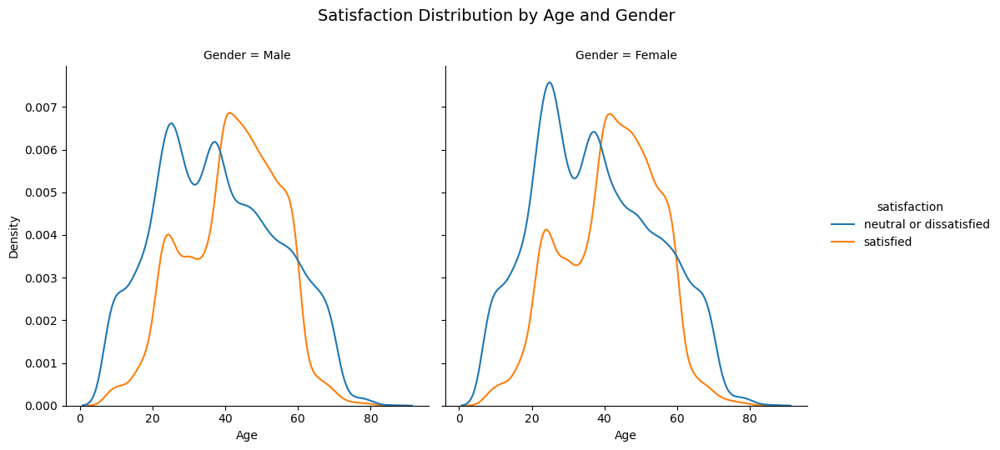

In [ ]:
### Satisfaction by Age and Gender ###

ax = sns.displot(data=df_air_train, kind='kde', x='Age', hue='satisfaction', col='Gender')
ax.fig.suptitle('Satisfaction Distribution by Age and Gender', y=1.07, fontsize=14)

plt.show()

It can be seen from the above code cell that both gender from all ages have pretty similar distribution of satisfaction. There is not any distinguishable difference between both gender in term of satisfaction distribution. Most of the neutral or dissatisfied customers comes from the younger age (around 20-25 years old) and early middle age (marginally below 40 years old). On the other hand, most of the satisfied customers comes from the middle age group (around 40-50 years old).

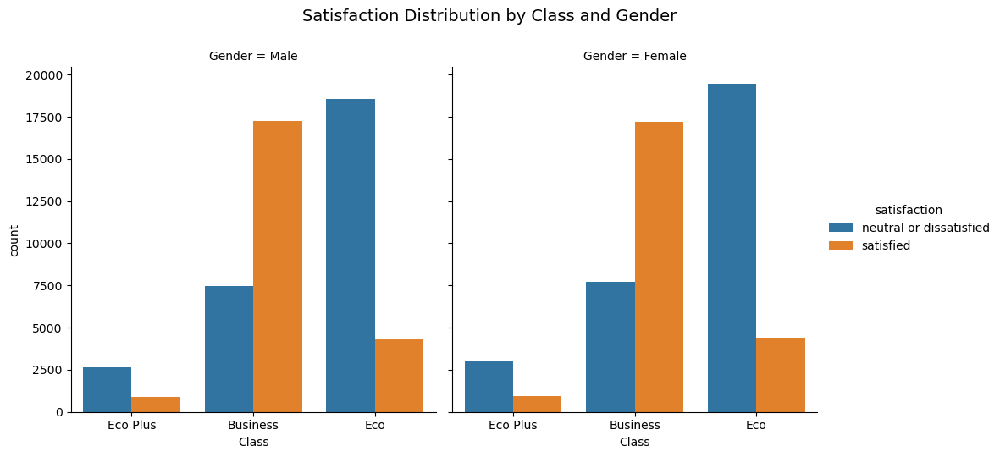

In [ ]:
### Satisfaction by Class and Gender ###

ax = sns.catplot(data=df_air_train, kind='count', x='Class', hue='satisfaction', col='Gender')
ax.fig.suptitle('Satisfaction Distribution by Class and Gender', y=1.07, fontsize=14)

plt.show()

It can be seen from the above code cell that both gender have similar satisfaction distribution for each class. Satisfied customers dominated the business class while the eco and eco plus customers seemed to be neutral or dissatisfied. This difference might be caused by the different services that the airline provided for those classes. The business class customers might have signifcantly better services compared to those in eco and eco plus.

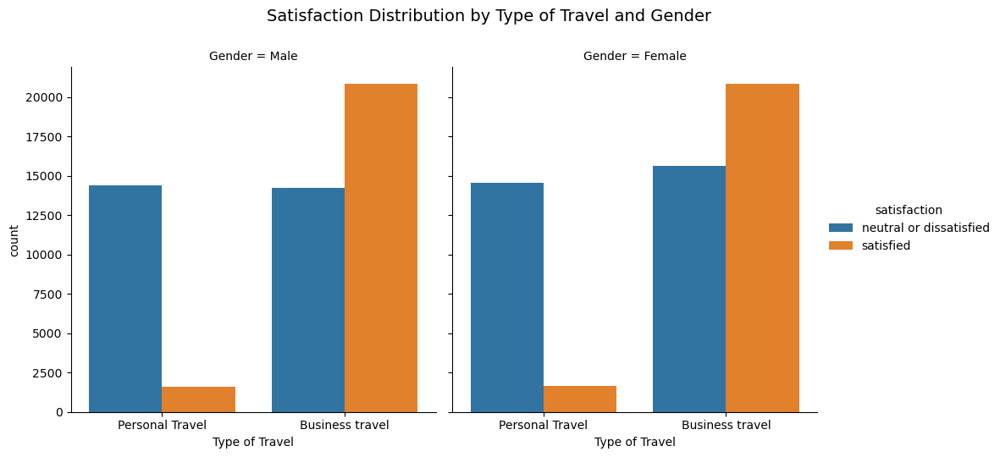

In [ ]:
### Satisfaction by Type of Travel and Gender ###

ax = sns.catplot(data=df_air_train, kind='count', x='Type of Travel', hue='satisfaction', col='Gender')
ax.fig.suptitle('Satisfaction Distribution by Type of Travel and Gender', y=1.07, fontsize=14)

plt.show()

It can be seen from the above code cell that both gender have similar satisfaction distribution for each type of travel. Most sustomers that went to travel for business purposes seems to be satisfied with the services provided by the airline, whereas most customers that went to travel for personal purposes feels neutral or dissatisfied.

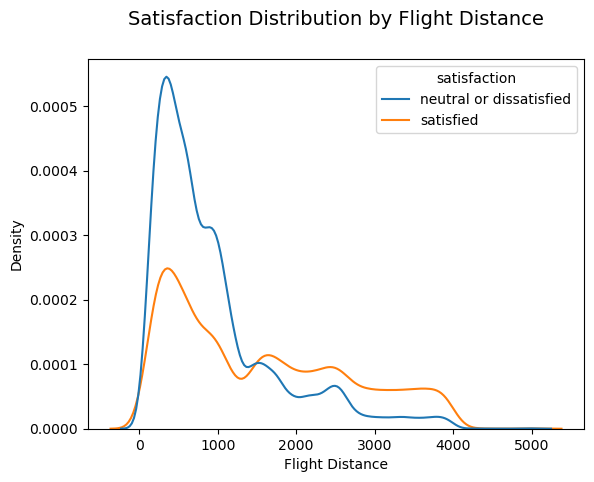

In [ ]:
### Satisfaction by Flight Distance ###

sns.kdeplot(data=df_air_train, x='Flight Distance', hue='satisfaction')
plt.title('Satisfaction Distribution by Flight Distance', y=1.07, fontsize=14)

plt.show()

It can be seen from the above plot that customers who felt neutral or dissatisfied with the airline dominated the flight with shorter distances. However as the distance of the travel increases, the neutrality or dissatisfaction of the customers decreases and most of them felt satisfied. This may indicate that flights with longer distance have better overall services compared to those with shorter distances.

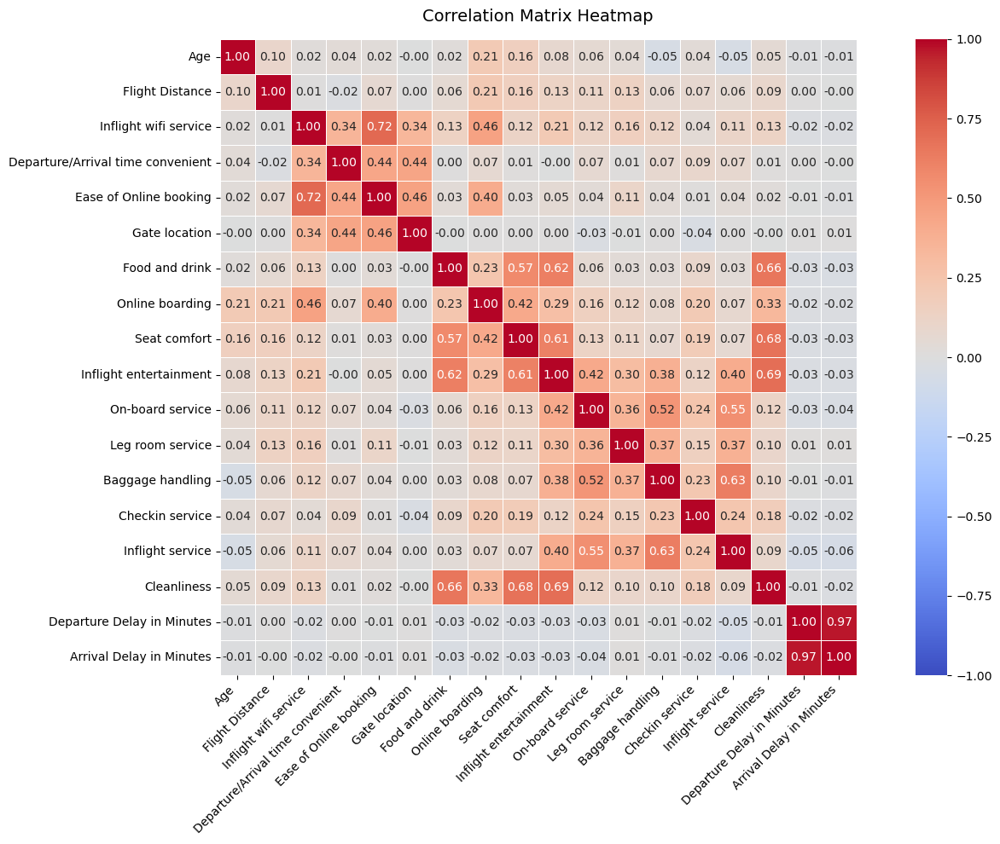

In [ ]:
### Correlation between the Numerical Features ###

df_air_num = df_air_train.select_dtypes(include='number').\
             drop(columns=['Unnamed: 0', 'id'])   # select only the numerical features exluding "Unnamed: 0" and "id" columns
df_corr = df_air_num.corr()  # create the correlation matrix

# Create the correlation heatmap
plt.figure(figsize=(15, 10))  # Set figure size
sns.heatmap(
    df_corr,
    annot=True,              # Show correlation values
    cmap='coolwarm',         # Color scheme (alternatives: 'viridis', 'Blues', 'RdBu')
    vmin=-1, vmax=1,         # Range for correlation values
    center=0,                # Center point for diverging colormap
    square=True,             # Make cells square
    linewidths=0.5,          # Width of lines between cells
    fmt='.2f',               # Format for annotation (2 decimal places)
    annot_kws={'size': 10}   # Font size for annotations
)

# Customize the heatmap
plt.title('Correlation Matrix Heatmap', fontsize=14, pad=15)
plt.xticks(rotation=45, ha='right')  # Rotate x-axis labels for readability
plt.yticks(rotation=0)               # Keep y-axis labels horizontal
plt.tight_layout()                   # Adjust layout to prevent clipping

# Display the plot
plt.show()

It can be seen from the correlation heatmap above that some features have moderate to high correlation with each other. Those features are for examples:
1. "Departure Delay in Minutes" and "Arrival Delay in Minutes" with correlation coefficient of __0.97 (highly correlated)__
2. "Cleanliness" and "Inflight entertainment" with correlation coefficient of 0.69 (moderately correlated)
3. "Inflight wifi service" and "Ease of online booking" with correlation coefficient of __0.72 (highly correlated)__
4. etc.

The presences of moderate to highly correlated features might indicate the possibility of multicollinearity issue in the dataset. To make sure whether this is true or not, the multicollinearity will be checked in the upcoming section.

## Data Cleaning

In [ ]:
### Remove Unnecessary Columns ###

df_air_train.drop(columns=['Unnamed: 0', 'id'], inplace=True)
df_air_test.drop(columns=['Unnamed: 0', 'id'], inplace=True)

# These two columns serve no function in the model building processes so we opt to delete them.

In [ ]:
### Remove NANs in "Arrival Delay in Minutes" Column ###

df_air_train.dropna(inplace=True)
df_air_test.dropna(inplace=True)

'''
As being mentioned before, because the number of missing value in the data is small, we opt to remove them.
Removing those data will not have significant impacts.
'''

print(df_air_train.info())
print('\n')
print(df_air_test.info())

<class 'pandas.core.frame.DataFrame'>
Index: 103594 entries, 0 to 103903
Data columns (total 23 columns):
 #   Column                             Non-Null Count   Dtype  
---  ------                             --------------   -----  
 0   Gender                             103594 non-null  object 
 1   Customer Type                      103594 non-null  object 
 2   Age                                103594 non-null  int64  
 3   Type of Travel                     103594 non-null  object 
 4   Class                              103594 non-null  object 
 5   Flight Distance                    103594 non-null  int64  
 6   Inflight wifi service              103594 non-null  int64  
 7   Departure/Arrival time convenient  103594 non-null  int64  
 8   Ease of Online booking             103594 non-null  int64  
 9   Gate location                      103594 non-null  int64  
 10  Food and drink                     103594 non-null  int64  
 11  Online boarding                    103594 no

In [ ]:
### Change the Type of some Columns ###

air_obj_to_cat = ['Gender', 'Customer Type', 'Type of Travel', 'Class']

# Change object columns to category
for col in air_obj_to_cat:
    df_air_train[col] = df_air_train[col].astype('category')
    df_air_test[col] = df_air_test[col].astype('category')

print('Train data column types: \n')
print(df_air_train.dtypes)
print('\nTest data column types: \n')
print(df_air_test.dtypes)

Train data column types: 

Gender                               category
Customer Type                        category
Age                                     int64
Type of Travel                       category
Class                                category
Flight Distance                         int64
Inflight wifi service                   int64
Departure/Arrival time convenient       int64
Ease of Online booking                  int64
Gate location                           int64
Food and drink                          int64
Online boarding                         int64
Seat comfort                            int64
Inflight entertainment                  int64
On-board service                        int64
Leg room service                        int64
Baggage handling                        int64
Checkin service                         int64
Inflight service                        int64
Cleanliness                             int64
Departure Delay in Minutes              int64
Arrival

## Multicollinearity Checking

Multicollinearity is a condition where two or more numerical features have high correlation with each other. This problem could affect models that use linear relationship or coefficient estimation. Multicollinearity might not affect their estimation, but it could make them unreliable, vague, or imprecise because it could inflates some or all of the coefficients (Investopedia 2024). To check for the present of multicollinearity, we are going to see the VIF values for each numerical feature.

In [ ]:
### Multicollinearity Checking ###

# Create a dataframe that contains only the numerical features
df_air_num = df_air_train.select_dtypes('number')

# Create a dataframe that contains the VIF values for each feature
df_vif_air = pd.DataFrame()
df_vif_air['Features'] = df_air_num.columns
df_vif_air['VIF'] = [vif(df_air_num, i) for i in range(df_air_num.shape[1])]

df_vif_air

,Features,VIF
0,Age,7.305013
1,Flight Distance,2.735255
2,Inflight wifi service,12.645468
3,Departure/Arrival time convenient,7.369203
4,Ease of Online booking,12.972389
5,Gate location,8.799044
6,Food and drink,13.853476
7,Online boarding,13.766166
8,Seat comfort,18.355230
9,Inflight entertainment,26.672515


The cutoffs for the VIF values are as follows (Menard 2001):
1. $VIF>5$ is cause for concern
2. $VIF>10$ serious collinearity problem

From the cell above, we can see that there is only 1 variable that has $VIF<5$. Most of them have $VIF>10$ which indicates a serious multicollinearity problem in the training data.

Machine learning algorithms that will be affected heavily by multicollinearity are those who rely on linear relationship or coefficient estimation (such as linear regression with OLS, logistic regression, etc.) (Alison 2012). To resolve or mitigate the effect of multicollinearity on those algorithms, below solutions can be applied.
1. Remove the features that strongly correlates with each other
2. Use regularization technique (l2 regularization or ridge)
3. Perform PCA prior to executing the algorithm

References:
- Menard S. Applied Logistic Regression Analysis. 2nd edition. SAGE Publications, Inc; 2001.
- Allison, P 2012, _Statistical Horizons_, USA,
accessed 27 March 2025, <https://statisticalhorizons.com/multicollinearity/>.
- Investopedia 2024, _Investopedia_,
viewed 19 April 2025, <https://www.investopedia.com/terms/m/multicollinearity.asp>.

## Data Preprocessing

In [ ]:
### Change the Values in "satisfaction" Column to Numeric ###

'''
Because the satisfaction column is still in the form of a text (object), it needs to be converted to numeric form so that it can be processed by
the scikit-learn library.
'''

# Convert 'neutral or dissatisfied' to 0 and 'satisfied' to 1
dict_satisfaction = {'neutral or dissatisfied': 0, 'satisfied': 1}
df_air_train['satisfaction'] = df_air_train['satisfaction'].map(dict_satisfaction)
df_air_test['satisfaction'] = df_air_test['satisfaction'].map(dict_satisfaction)

print('Train data satisfaction distinct values:', df_air_train['satisfaction'].unique())
print('Train data satisfaction distinct values:', df_air_test['satisfaction'].unique())

Train data satisfaction distinct values: [0 1]
Train data satisfaction distinct values: [1 0]


In [ ]:
### Separate the Train and Test Data to Features and Target Variables ###

X_train_air = df_air_train.drop(columns='satisfaction')
y_train_air = df_air_train.iloc[:, -1]
X_test_air = df_air_test.drop(columns='satisfaction')
y_test_air = df_air_test.iloc[:, -1]

print(X_train_air.shape)
print(y_train_air.shape)
print(X_test_air.shape)
print(y_test_air.shape)

(103594, 22)
(103594,)
(25893, 22)
(25893,)


In [ ]:
### Create Dummies for Categorical Variables ###

'''
The categorical features need to be converted to dummies so that it can be processed by the scikit-learn library
'''

df_air_train_cat = df_air_train.select_dtypes(include='category')
df_air_test_cat = df_air_test.select_dtypes(include='category')

X_train_air_dummies = pd.get_dummies(df_air_train_cat)
X_test_air_dummies = pd.get_dummies(df_air_test_cat)

print(f'Train data dummies: \n{X_train_air_dummies.shape}')
display(X_train_air_dummies.head())
print(f'\nTrain data dummies: \n{X_test_air_dummies.shape}')
display(X_test_air_dummies.head())

Train data dummies: 
(103594, 9)


,Gender_Female,Gender_Male,Customer Type_Loyal Customer,Customer Type_disloyal Customer,Type of Travel_Business travel,Type of Travel_Personal Travel,Class_Business,Class_Eco,Class_Eco Plus
0,False,True,True,False,False,True,False,False,True
1,False,True,False,True,True,False,True,False,False
2,True,False,True,False,True,False,True,False,False
3,True,False,True,False,True,False,True,False,False
4,False,True,True,False,True,False,True,False,False



Train data dummies: 
(25893, 9)


,Gender_Female,Gender_Male,Customer Type_Loyal Customer,Customer Type_disloyal Customer,Type of Travel_Business travel,Type of Travel_Personal Travel,Class_Business,Class_Eco,Class_Eco Plus
0,True,False,True,False,True,False,False,True,False
1,True,False,True,False,True,False,True,False,False
2,False,True,False,True,True,False,False,True,False
3,False,True,True,False,True,False,True,False,False
4,True,False,True,False,True,False,False,True,False


In [ ]:
### Perform Feature Scaling on the Numerical Variables ###

'''
RobustScaler will be used because there are some outliers in the data (such as in "age" and "flight distance" columns).
StandardScaler and MinMaxScaler are very sensitive to outliers (Scikit-learn 2025)
Reference:
Scikit-learn, accessed 24 March 2025, https://scikit-learn.org/stable/auto_examples/preprocessing/plot_all_scaling.html
'''

df_air_train_num = X_train_air.select_dtypes(include='number')
df_air_test_num = X_test_air.select_dtypes(include='number')

RobustScale = RobustScaler()
X_train_air_scaled_num = RobustScale.fit_transform(df_air_train_num)
X_test_air_scaled_num = RobustScale.transform(df_air_test_num)

X_train_air_scaled_num = pd.DataFrame(X_train_air_scaled_num,
                                      columns = df_air_train_num.columns,
                                      index = df_air_train_num.index)
X_test_air_scaled_num = pd.DataFrame(X_test_air_scaled_num,
                                     columns = df_air_test_num.columns,
                                     index = df_air_test_num.index)

print(f'Train numerical variables scaled: \n{X_train_air_scaled_num.shape}')
display(X_train_air_scaled_num.head())
print(f'\nTest numerical variables scaled: \n{X_test_air_scaled_num.shape}')
display(X_test_air_scaled_num.head())

Train numerical variables scaled: 
(103594, 18)


,Age,Flight Distance,Inflight wifi service,Departure/Arrival time convenient,Ease of Online booking,Gate location,Food and drink,Online boarding,Seat comfort,Inflight entertainment,On-board service,Leg room service,Baggage handling,Checkin service,Inflight service,Cleanliness,Departure Delay in Minutes,Arrival Delay in Minutes
0,-1.125000,-0.287434,0.0,0.5,0.0,-1.0,1.0,0.0,0.333333,0.5,0.0,-0.5,0.0,1.0,0.5,1.0,2.083333,1.384615
1,-0.625000,-0.456734,0.0,-0.5,0.0,0.0,-1.0,0.0,-1.000000,-1.5,-1.5,0.5,-0.5,-2.0,0.0,-1.0,0.083333,0.461538
2,-0.583333,0.225734,-0.5,-0.5,-0.5,-0.5,1.0,1.0,0.333333,0.5,0.0,-0.5,0.0,1.0,0.0,1.0,0.000000,0.000000
3,-0.625000,-0.210685,-0.5,1.0,1.0,1.0,-0.5,-0.5,-0.666667,-1.0,-1.0,0.5,-0.5,-2.0,0.0,-0.5,0.916667,0.692308
4,0.875000,-0.472536,0.0,0.0,0.0,0.0,0.5,1.0,0.333333,-0.5,-0.5,0.0,0.0,0.0,-0.5,0.0,0.000000,0.000000



Test numerical variables scaled: 
(25893, 18)


,Age,Flight Distance,Inflight wifi service,Departure/Arrival time convenient,Ease of Online booking,Gate location,Food and drink,Online boarding,Seat comfort,Inflight entertainment,On-board service,Leg room service,Baggage handling,Checkin service,Inflight service,Cleanliness,Departure Delay in Minutes,Arrival Delay in Minutes
0,0.500000,-0.513168,1.0,0.5,0.0,0.5,0.0,0.5,-0.333333,0.5,0.5,0.5,0.5,-1.0,0.5,1.0,4.166667,3.384615
1,-0.166667,1.520692,-1.0,-1.0,0.0,-1.0,1.0,0.5,0.333333,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.000000,0.000000
2,-0.833333,-0.489090,-0.5,-1.5,-0.5,0.5,-0.5,-0.5,-0.666667,-1.0,0.0,-1.5,-0.5,-1.0,-1.0,-0.5,0.000000,0.000000
3,0.166667,1.907449,-1.5,-1.5,-1.5,-0.5,0.0,0.5,0.000000,-1.5,-1.5,-1.5,-1.5,0.0,-1.5,0.5,0.000000,0.461538
4,0.375000,0.255831,-0.5,0.0,0.5,0.0,0.5,-1.0,-0.666667,-1.0,-1.0,-1.0,-1.0,1.0,-1.0,0.5,0.000000,1.538462


In [ ]:
### Combine the Numerical and Categorical Variables into One Dataframe ###

'''
Because the categorical and numerical features are still in different dataframes, they need to be joined together in a single dataframe.
'''

X_train_air_scaled = pd.concat([X_train_air_scaled_num, X_train_air_dummies], axis=1)
X_test_air_scaled = pd.concat([X_test_air_scaled_num, X_test_air_dummies], axis=1)

print(X_train_air_scaled.shape)
print(X_test_air_scaled.shape)

(103594, 27)
(25893, 27)


## Machine Learning Model Building & Hyperparameter Fine Tuning

### a. Logistic Regression

In [ ]:
### Model Building & Performance in Training Set ###

lr_mod_air = LogisticRegression(random_state=123)

# Measure training model running time
start_time = time.time()
lr_mod_air.fit(X_train_air_scaled, y_train_air)
end_time = time.time()
train_time = end_time - start_time

# Measure training model prediction time
start_time = time.time()
y_train_lr_pred = lr_mod_air.predict(X_train_air_scaled)
end_time = time.time()
prediction_time = end_time - start_time

# Compute some evaluation scores
lr_mod_air_train_precision = precision_score(y_train_air, y_train_lr_pred)
lr_mod_air_train_f1 = f1_score(y_train_air, y_train_lr_pred)
lr_mod_air_train_auc = roc_auc_score(y_train_air, y_train_lr_pred)

print('Logistic regression model training set performances: ')
print(f'Precision score: {lr_mod_air_train_precision}')
print(f'F1 score: {lr_mod_air_train_f1}')
print(f'AUC score: {lr_mod_air_train_auc}')

print(f'\nModel training time: {train_time:.3f} seconds')
print(f'Model prediction time: {prediction_time:.3f} seconds')

Logistic regression model training set performances: 
Precision score: 0.8705451341387066
F1 score: 0.8530400799781878
AUC score: 0.8705547719475527

Model training time: 0.758 seconds
Model prediction time: 0.061 seconds


In [ ]:
### Validation Set Performance ###

lr_mod_air_val_precision = cross_val_score(lr_mod_air, X_train_air_scaled, y_train_air,
                                           scoring="precision", cv=5)
lr_mod_air_val_f1 = cross_val_score(lr_mod_air, X_train_air_scaled, y_train_air,
                                    scoring="f1", cv=5)
lr_mod_air_val_auc = cross_val_score(lr_mod_air, X_train_air_scaled, y_train_air,
                                     scoring="roc_auc", cv=5)

print('Logistic regression model validation set performances: ')
print(f'Average precision score: {np.mean(lr_mod_air_val_precision)}')
print(f'Average F1 score: {np.mean(lr_mod_air_val_f1)}')
print(f'Average AUC score: {np.mean(lr_mod_air_val_auc)}')

Logistic regression model validation set performances: 
Average precision score: 0.8703396964209181
Average F1 score: 0.8528274680264667
Average AUC score: 0.9267346434362642


From the last 2 cells we can see that the logistic regression model has similar precision and f1 score on training and validation set. The noticeable difference is the AUC score for the validation set where the value increase around 5.5% from the training set.

In [ ]:
### Hyperparameters Tuning ###

warnings.filterwarnings('ignore')

lr_air_params = {
        'penalty': ['l1', 'l2'],
        'C': [0.001, 0.01, 0.1, 1.0, 10.0],
        'solver': ['liblinear', 'saga'],
        'max_iter': [50, 100, 200]
        }

# Halving grid search CV is used instead of grid search CV because it is faster in terms of computing time
lr_halving_grid_search = HalvingGridSearchCV(
    estimator=lr_mod_air,
    param_grid=lr_air_params,
    cv=5,
    scoring='precision',
    random_state=123
)

# Measure running time of the model
start_time = time.time()
lr_halving_grid_search.fit(X_train_air_scaled, y_train_air)
end_time = time.time()
running_time = end_time - start_time

# print halving grid search cv results
print("Logistic regression halving grid search CV best parameters:", lr_halving_grid_search.best_params_)
print("Best mean score:", lr_halving_grid_search.best_score_)

# print running time result
print(f'\nModel running time: {running_time/60:.2f} minutes')

Logistic regression halving grid search CV best parameters: {'C': 0.001, 'max_iter': 200, 'penalty': 'l2', 'solver': 'saga'}
Best mean score: 0.8706008494146456

Model running time: 7.26 minutes


From the above cell, it can be seen that the best hyperparameters for logistic regression in this data applied l2 regularization (ridge) and saga solver (one of optimization algorithms that is faster for larger dataset). However, tuning the hyperparameters did not enhance the precision score much. It only improved the precision score around 0.03%, which is very small. This could indicate that both model have similar performance and capabilities on this dataset and either one can be chosen for this dataset.

Furthermore, because the dataset used experiences a multicollinearity problem, applying l2 regularization may solve that problem in logistic regression.

In [ ]:
### Logistic Regression Model Overview Using Statsmodel Library ###

# Convert the training target variable to Pandas Dataframe
df_y_train_air = pd.DataFrame(y_train_air)

# Remove the dummies that will be used as the baselines
X_train_air_scaled_no_base = X_train_air_scaled.drop(columns=['Gender_Female', 'Customer Type_Loyal Customer',
                                                              'Type of Travel_Business travel','Class_Business'])\
                                                     .astype(float) # convert to float so that this can be processed by statsmodels.api.Logit()

lr_smf_air_mod = sm.Logit(df_y_train_air, X_train_air_scaled_no_base)
lr_smf_air_result = lr_smf_air_mod.fit()
lr_smf_air_result.summary()

Optimization terminated successfully.
         Current function value: 0.352325
         Iterations 7


<class 'statsmodels.iolib.summary.Summary'>
"""
                           Logit Regression Results                           
==============================================================================
Dep. Variable:           satisfaction   No. Observations:               103594
Model:                          Logit   Df Residuals:                   103571
Method:                           MLE   Df Model:                           22
Date:                Wed, 26 Mar 2025   Pseudo R-squ.:                  0.4851
Time:                        22:30:37   Log-Likelihood:                -36499.
converged:                       True   LL-Null:                       -70884.
Covariance Type:            nonrobust   LLR p-value:                     0.000
=====================================================================================================
                                        coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------------------------------------------------------------
Age                                  -0.0383      0.017     -2.315      0.021      -0.071      -0.006
Flight Distance                       0.3681      0.013     28.194      0.000       0.342       0.394
Inflight wifi service                 0.7076      0.022     31.839      0.000       0.664       0.751
Departure/Arrival time convenient    -0.2643      0.016    -16.252      0.000      -0.296      -0.232
Ease of Online booking               -0.3554      0.022    -15.916      0.000      -0.399      -0.312
Gate location                         0.0965      0.018      5.331      0.000       0.061       0.132
Food and drink                        0.1409      0.020      7.008      0.000       0.101       0.180
Online boarding                       1.5368      0.019     79.271      0.000       1.499       1.575
Seat comfort                         -0.3663      0.031    -11.635      0.000      -0.428      -0.305
Inflight entertainment               -0.0865      0.028     -3.126      0.002      -0.141      -0.032
On-board service                      0.5209      0.020     26.038      0.000       0.482       0.560
Leg room service                      0.4145      0.017     24.678      0.000       0.382       0.447
Baggage handling                      0.2445      0.022     10.904      0.000       0.201       0.288
Checkin service                       0.3491      0.008     41.919      0.000       0.333       0.365
Inflight service                      0.2877      0.024     12.191      0.000       0.241       0.334
Cleanliness                           0.6945      0.023     30.276      0.000       0.650       0.739
Departure Delay in Minutes            0.0583      0.011      5.103      0.000       0.036       0.081
Arrival Delay in Minutes             -0.0919      0.012     -7.539      0.000      -0.116      -0.068
Gender_Male                           0.5172      0.017     29.772      0.000       0.483       0.551
Customer Type_disloyal Customer      -1.4278      0.028    -51.557      0.000      -1.482      -1.374
Type of Travel_Personal Travel       -2.4578      0.031    -78.798      0.000      -2.519      -2.397
Class_Eco                            -0.1621      0.024     -6.728      0.000      -0.209      -0.115
Class_Eco Plus                       -0.1456      0.040     -3.683      0.000      -0.223      -0.068
=====================================================================================================
"""

__Logistic regression model interpretation__

P-value interpretation:

$H_0: \beta_i = 0$

$H_1: \beta_i \neq 0$

Using $alpha=0.05$, $H_0$ will be rejected if $p-value<alpha$. Because all the model coefficients have $p-value<alpha=0.05$, it means that $H_0$ will be rejected and $H_1$ proven true for all the coefficients ($\beta$). It can be indicated that all the features have statistically significant effect/impact on the target variable, which is satisfaction.

Coefficient ($\beta$) interpretation:

- Numerical features: Because the numerical features are transformed using a standardisation method (which is RobustScaler), they will lose their inital units or scales. All the numerical features will be in the same unit or scale. Hence, the interpretation for the numerical features will be slightly different. For example, using the coefficient for "Flight Distance", $\beta = 0.3681$ then the odds ratio is $e^{0.3681} \approx 1.44$. This could indicate that a one-standard-deviation increase in the distance of the flight increases the odds of the customer to be satisfied by around 44%.
- Categorical features: For example, using the coefficient for "Gender", $\beta_{male} = 0.5172$ then the odds ratio is $e^{0.5172} \approx 1.68$. This could indicate that the odds of male customers to be satisfied are 68% higher or 1.68 times the odds of female customers to be satisfied.

### b. Decision Tree Classifier

In [ ]:
### Model Building & Performance in Training Set ###

dtc_mod_air = DecisionTreeClassifier(random_state=123)

# Measure training model running time
start_time = time.time()
dtc_mod_air.fit(X_train_air_scaled, y_train_air)
end_time = time.time()
train_time = end_time - start_time

# Measure model prediction time
start_time = time.time()
y_train_dtc_pred = dtc_mod_air.predict(X_train_air_scaled)
end_time = time.time()
prediction_time = end_time - start_time

# Compute some evaluation scores
dtc_mod_air_train_precision = precision_score(y_train_air, y_train_dtc_pred)
dtc_mod_air_train_f1 = f1_score(y_train_air, y_train_dtc_pred)
dtc_mod_air_train_auc = roc_auc_score(y_train_air, y_train_dtc_pred)

print('Decision tree model training set performances: ')
print(f'Precision score: {dtc_mod_air_train_precision}')
print(f'F1 score: {dtc_mod_air_train_f1}')
print(f'AUC score: {dtc_mod_air_train_auc}')

print(f'\nModel training time: {train_time:.3f} seconds')
print(f'Model prediction time: {prediction_time:.3f} seconds')

Decision tree model training set performances: 
Precision score: 1.0
F1 score: 1.0
AUC score: 1.0

Model training time: 1.579 seconds
Model prediction time: 0.049 seconds


In [ ]:
### Validation Set Performance ###

dtc_mod_air_val_precision = cross_val_score(dtc_mod_air, X_train_air_scaled, y_train_air,
                                            scoring="precision", cv=5)
dtc_mod_air_val_f1 = cross_val_score(dtc_mod_air, X_train_air_scaled, y_train_air,
                                     scoring="f1", cv=5)
dtc_mod_air_val_auc = cross_val_score(dtc_mod_air, X_train_air_scaled, y_train_air,
                                      scoring="roc_auc", cv=5)

print('Decision tree model validation set performances: ')
print(f'Average precision score: {np.mean(dtc_mod_air_val_precision)}')
print(f'Average F1 score: {np.mean(dtc_mod_air_val_f1)}')
print(f'Average AUC score: {np.mean(dtc_mod_air_val_auc)}')

Decision tree model validation set performances: 
Average precision score: 0.9322844939121383
Average F1 score: 0.9354703887555049
Average AUC score: 0.9432663688897958


From the last 2 cells above we can see that the decision tree model somewhat experience a mild overfitting. The reason is because the precision, f1, and AUC score of the model decrease around 6-7% for each of them from the training set to the validation set. However, the model can still generalize well enough on the validation set due to the high scores of precision, f1, and AUC on the validation set.

In [ ]:
### Hyperparameters Tuning ###

warnings.filterwarnings('ignore')

dtc_air_params = {
         'max_depth': [3, 7, 10, None],
         'min_samples_split': [2, 5, 10],
         'min_samples_leaf': [1, 2, 4],
         'criterion': ['gini', 'entropy']
         }

# Halving grid search CV is used instead of grid search CV because it is faster in terms of computing time
dtc_halving_grid_search = HalvingGridSearchCV(
     estimator=dtc_mod_air,
     param_grid=dtc_air_params,
     cv=5,
     scoring='precision',
     random_state=333
)

# Measure running time of the model
start_time = time.time()
dtc_halving_grid_search.fit(X_train_air_scaled, y_train_air)
end_time = time.time()
running_time = end_time - start_time

# print halving grid search cv results
print("Decision tree halving grid search CV best parameters:", dtc_halving_grid_search.best_params_)
print("Best mean score:", dtc_halving_grid_search.best_score_)

# print running time result
print(f'\nModel running time: {running_time/60:.2f} minutes')

Decision tree halving grid search CV best parameters: {'criterion': 'entropy', 'max_depth': 10, 'min_samples_leaf': 1, 'min_samples_split': 10}
Best mean score: 0.9536542915682558

Model running time: 1.01 minutes


From the above cell, it can be seen that the best hyperparameters for decision tree model in this dataset applied entropy impurity measure, maximum depth of 10 layers or levels, required a minimum of 10 observations to split a node, and only a minimum of 1 observation required to be in a leaf node. Tuning the hyperparameters augment the decision tree model's precision score slightly around 2%. This could indicate that the tuned decision tree model offers a slightly better performance and capabilities on capturing this dataset compared to the pre-tuned model.

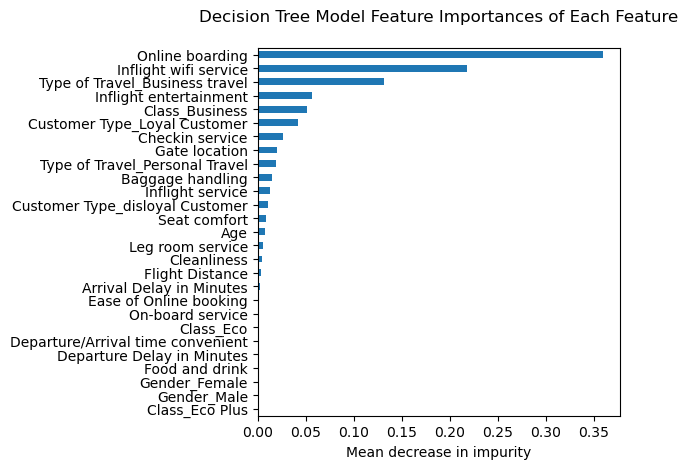

In [ ]:
### Showing the Feature Importance for Each Feature ###

# Build decision tree model with the best hyperparameters obtained from halving grid search cv
dtc_air_best_params = DecisionTreeClassifier(**dtc_halving_grid_search.best_params_, random_state=333).fit(X_train_air_scaled, y_train_air)

# Extract the importance scores of each features
air_importances = dtc_air_best_params.feature_importances_
sort_air_idx = np.argsort(air_importances) # sort by importances descendingly
air_importances = air_importances[sort_air_idx]

# Extract the name of each features
air_feature_names = dtc_air_best_params.feature_names_in_
air_feature_names = air_feature_names[sort_air_idx] # sort the feature names based on descending order of importance scores

# Combine both the importances score and feature names in a Pandas Series
dtc_air_importances = pd.Series(air_importances, index=air_feature_names)

fig, ax = plt.subplots()
dtc_air_importances.plot.barh(ax=ax)
ax.set_title("Decision Tree Model Feature Importances of Each Feature", y=1.05)
ax.set_xlabel("Mean decrease in impurity")
fig.tight_layout()

Based on the plot above, the top 5 most important features for the airline customer's satisfaction are:
1. Online boarding
2. Inflight WIFI service
3. Business type of travel
4. Inflight entertainment
5. Business class

The airline might want to prioritise these aspects first compared to the other aspects in order to improve their customer's overall satisfaction.

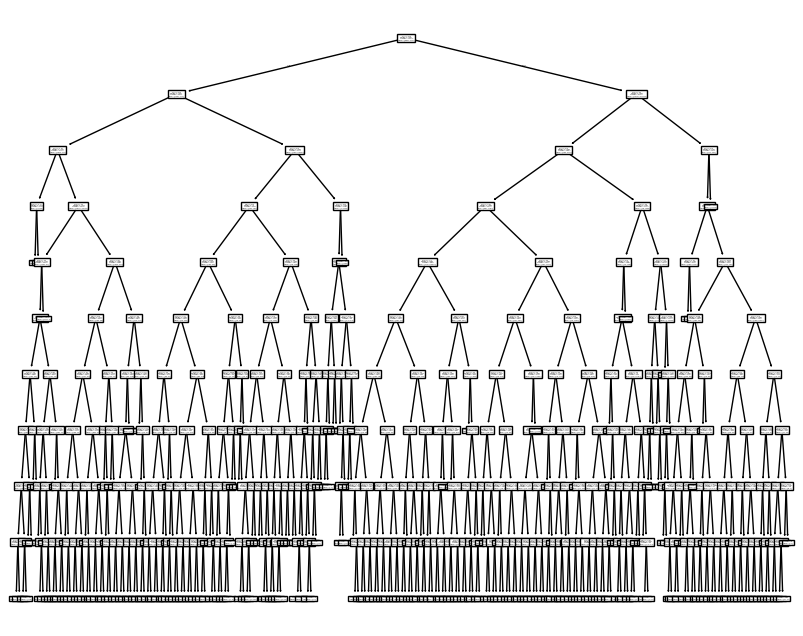

In [ ]:
### Plotting the Tree ###

plt.figure(figsize=(10, 8))
plot_tree(dtc_halving_grid_search.best_estimator_)
plt.show()

### c. Artificial Neural Network (Multilayer Perceptrons Classifier)

In [ ]:
### Model Building & Performance in Training Set ###

warnings.filterwarnings("ignore", category=ConvergenceWarning)

ann_mod_air = MLPClassifier(random_state=123,
                            max_iter=50,
                            early_stopping=True, # the hyperparameters are set these ways so that the model have faster computing time
                            batch_size=300)

# Measure training model running time
start_time = time.time()
ann_mod_air.fit(X_train_air_scaled, y_train_air)
end_time = time.time()
train_time = end_time - start_time

# Measure prediction time
start_time = time.time()
y_train_ann_pred = ann_mod_air.predict(X_train_air_scaled)
end_time = time.time()
prediction_time = end_time - start_time

# Compute some evaluation scores
ann_mod_air_train_precision = precision_score(y_train_air, y_train_ann_pred)
ann_mod_air_train_f1 = f1_score(y_train_air, y_train_ann_pred)
ann_mod_air_train_auc = roc_auc_score(y_train_air, y_train_ann_pred)

print('ANN model training set performances: ')
print(f'Precision score: {ann_mod_air_train_precision}')
print(f'F1 score: {ann_mod_air_train_f1}')
print(f'AUC score: {ann_mod_air_train_auc}')

print(f'\nModel training time: {train_time:.3f} seconds')
print(f'Model prediction time: {prediction_time:.3f} seconds')

ANN model training set performances: 
Precision score: 0.9697962738043403
F1 score: 0.9559943072717826
AUC score: 0.9600626915932748

Model training time: 39.290 seconds
Model prediction time: 0.113 seconds


In [ ]:
### Validation Set Performance ###

warnings.filterwarnings("ignore", category=ConvergenceWarning)

ann_mod_air_val_precision = cross_val_score(ann_mod_air, X_train_air_scaled, y_train_air,
                                            scoring="precision", cv=5)
ann_mod_air_val_f1 = cross_val_score(ann_mod_air, X_train_air_scaled, y_train_air,
                                     scoring="f1", cv=5)
ann_mod_air_val_auc = cross_val_score(ann_mod_air, X_train_air_scaled, y_train_air,
                                      scoring="roc_auc", cv=5)

print('ANN model validation set performances: ')
print(f'Average precision score: {np.mean(ann_mod_air_val_precision)}')
print(f'Average F1 score: {np.mean(ann_mod_air_val_f1)}')
print(f'Average AUC score: {np.mean(ann_mod_air_val_auc)}')

ANN model validation set performances: 
Average precision score: 0.9648577461515775
Average F1 score: 0.9508069576397835
Average AUC score: 0.9931901799611665


From the last 2 cells above we can see that the ANN model can generalize well on unseen data (validation set). This is because the ANN model has similar precision, f1, and AUC scores on both training and validation set. The only difference is the AUC score where the value slightly jumps around 3%.

In [ ]:
### Hyperparameters Tuning ###

warnings.filterwarnings('ignore')

ann_air_params = {
        'hidden_layer_sizes': [(50,), (100,), (100, 50)],
        'activation': ['relu', 'tanh'],
        'alpha': [0.0001, 0.001],
        'learning_rate_init': [0.001, 0.01]
         }

# Halving grid search CV is used instead of grid search CV because it is faster in terms of computing time
ann_halving_grid_search = HalvingGridSearchCV(
    estimator=ann_mod_air,
    param_grid=ann_air_params,
    cv=5,
    scoring='precision',
    random_state=123
)

# Measure running time of the model
start_time = time.time()
ann_halving_grid_search.fit(X_train_air_scaled, y_train_air)
end_time = time.time()
running_time = end_time - start_time

# print halving grid search cv results
print("ANN halving grid search CV best parameters:", ann_halving_grid_search.best_params_)
print("Best mean score:", ann_halving_grid_search.best_score_)

# print running time result
print(f'\nModel running time: {running_time/60:.2f} minutes')

ANN randomized search CV best parameters: {'activation': 'relu', 'alpha': 0.001, 'hidden_layer_sizes': (100,), 'learning_rate_init': 0.01}
Best mean score: 0.9670095966746967

Model running time: 19.20 minutes


It can be seen from the above cell that the best hyperparameters for the ANN model are the usage of Rectified Linear Unit non-linear activation function, alpha of 0.001 where smaller alpha mean less regularisation power, 1 hidden layer consisting of 100 hidden units, and initial learning rate of 0.01. It can also be seen that tuning the hyperparameters did not improve the precision score much. The precision score only increased slightly.

### d. Random Forest Classifier

In [ ]:
### Model Building & Performance in Training Set ###

rf_mod_air = RandomForestClassifier(random_state=123)

# Measure training model running time
start_time = time.time()
rf_mod_air.fit(X_train_air_scaled, y_train_air)
end_time = time.time()
train_time = end_time - start_time

# Measure prediction time
start_time = time.time()
y_train_rf_pred = rf_mod_air.predict(X_train_air_scaled)
end_time = time.time()
prediction_time = end_time - start_time

# Compute some evaluation scores
rf_mod_air_train_precision = precision_score(y_train_air, y_train_rf_pred)
rf_mod_air_train_f1 = f1_score(y_train_air, y_train_rf_pred)
rf_mod_air_train_auc = roc_auc_score(y_train_air, y_train_rf_pred)

print('Random forest model training set performances: ')
print(f'Precision score: {rf_mod_air_train_precision}')
print(f'F1 score: {rf_mod_air_train_f1}')
print(f'AUC score: {rf_mod_air_train_auc}')

print(f'\nModel training time: {train_time:.3f} seconds')
print(f'Model prediction time: {prediction_time:.3f} seconds')

Random forest model training set performances: 
Precision score: 1.0
F1 score: 1.0
AUC score: 1.0

Model training time: 27.170 seconds
Model prediction time: 3.013 seconds


In [ ]:
### Validation Set Performance ###

rf_mod_air_val_precision = cross_val_score(rf_mod_air, X_train_air_scaled, y_train_air,
                                           scoring="precision", cv=5)
rf_mod_air_val_f1 = cross_val_score(rf_mod_air, X_train_air_scaled, y_train_air,
                                    scoring="f1", cv=5)
rf_mod_air_val_auc = cross_val_score(rf_mod_air, X_train_air_scaled, y_train_air,
                                     scoring="roc_auc", cv=5)

print('Random forest model validation set performances: ')
print(f'Average precision score: {np.mean(rf_mod_air_val_precision)}')
print(f'Average F1 score: {np.mean(rf_mod_air_val_f1)}')
print(f'Average AUC score: {np.mean(rf_mod_air_val_auc)}')

Random forest model validation set performances: 
Average precision score: 0.9725889679851916
Average F1 score: 0.9561744668598038
Average AUC score: 0.99395097234835


It can be seen from the last 2 cells above that the random forest model experienced a small overfitting. This is because the model prediction performances measured using precision, f1, and AUC scores dropped a little from the training set to validation set. Compared to the decision tree model, however, the drops in random forest model is slightly lower (only around 1-4%).

In [ ]:
### Hyperparameters Tuning ###

warnings.filterwarnings('ignore')

rf_air_params = {
        'n_estimators': [50, 100, 150],
        'max_depth': [5, 10, 15, None],
        'min_samples_split': [2, 5],
        'min_samples_leaf': [1, 2, 4],
        'criterion': ['gini', 'entropy']
         }

# Halving grid search CV is used instead of grid search CV because it is faster in terms of computing time
rf_halving_grid_search = HalvingGridSearchCV(
    estimator=rf_mod_air,
    param_grid=rf_air_params,
    cv=5,
    scoring='precision',
    random_state=333
)

# Measure running time of the model
start_time = time.time()
rf_halving_grid_search.fit(X_train_air_scaled, y_train_air)
end_time = time.time()
running_time = end_time - start_time

# print halving grid search cv results
print("Random forest halving grid search CV best parameters:", rf_halving_grid_search.best_params_)
print("Best mean score:", rf_halving_grid_search.best_score_)

# print running time result
print(f'\nModel running time: {running_time/60:.2f} minutes')

Random forest halving grid search CV best parameters: {'criterion': 'entropy', 'max_depth': None, 'min_samples_leaf': 1, 'min_samples_split': 2, 'n_estimators': 150}
Best mean score: 0.9744234383238295

Model running time: 23.13 minutes


It can be seen from the above cell that the best hyperparameters for random forest model in this dataset applied entropy impurity measure, no limitation for the depth of the tree, required a minimum of 1 observation on a leaf node, required a minimum of 2 observations to split a node, and has 150 number of trees. Moreover, tuning the hyperparameters did not enhance the performance of the model much as it only improved the precision score around 0.2%.

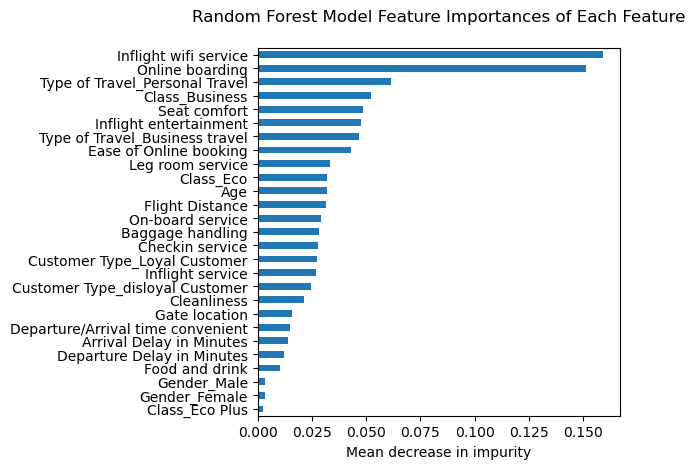

In [ ]:
### Showing the Feature Importance for Each Feature ###

# Build random forest model with the best hyperparameters obtained from halving grid search cv
rf_air_best_params = RandomForestClassifier(**rf_halving_grid_search.best_params_, random_state=333).fit(X_train_air_scaled, y_train_air)

# Extract the importance scores of each features
air_importances = rf_air_best_params.feature_importances_
sort_air_idx = np.argsort(air_importances) # sort by importances descendingly
air_importances = air_importances[sort_air_idx]

# Extract the name of each features
air_feature_names = rf_air_best_params.feature_names_in_
air_feature_names = air_feature_names[sort_air_idx] # sort the feature names based on descending order of importance scores

# Combine both the importances score and feature names in a Pandas Series
rf_air_importances = pd.Series(air_importances, index=air_feature_names)

fig, ax = plt.subplots()
rf_air_importances.plot.barh(ax=ax)
ax.set_title("Random Forest Model Feature Importances of Each Feature", y=1.05)
ax.set_xlabel("Mean decrease in impurity")
fig.tight_layout()

### e. Gradient Boosted Classifier

In [ ]:
### Model Building & Performance in Training Set ###

gbc_mod_air = GradientBoostingClassifier(random_state=123)

# Measure training model running time
start_time = time.time()
gbc_mod_air.fit(X_train_air_scaled, y_train_air)
end_time = time.time()
train_time = end_time - start_time

# Measure prediction time
start_time = time.time()
y_train_gbc_pred = gbc_mod_air.predict(X_train_air_scaled)
end_time = time.time()
prediction_time = end_time - start_time

# Compute some evaluation scores
gbc_mod_air_train_precision = precision_score(y_train_air, y_train_gbc_pred)
gbc_mod_air_train_f1 = f1_score(y_train_air, y_train_gbc_pred)
gbc_mod_air_train_auc = roc_auc_score(y_train_air, y_train_gbc_pred)

print('Gradient boosted model training set performances: ')
print(f'Precision score: {gbc_mod_air_train_precision}')
print(f'F1 score: {gbc_mod_air_train_f1}')
print(f'AUC score: {gbc_mod_air_train_auc}')

print(f'\nModel training time: {train_time:.3f} seconds')
print(f'Model prediction time: {prediction_time:.3f} seconds')

Gradient boosted model training set performances: 
Precision score: 0.9451205563435056
F1 score: 0.9325027366805476
AUC score: 0.9396732365638821

Model training time: 40.182 seconds
Model prediction time: 0.450 seconds


In [ ]:
### Validation Set Performance ###

gbc_mod_air_val_precision = cross_val_score(gbc_mod_air, X_train_air_scaled, y_train_air,
                                            scoring="precision", cv=5)
gbc_mod_air_val_f1 = cross_val_score(gbc_mod_air, X_train_air_scaled, y_train_air,
                                     scoring="f1", cv=5)
gbc_mod_air_val_auc = cross_val_score(gbc_mod_air, X_train_air_scaled, y_train_air,
                                      scoring="roc_auc", cv=5)

print('Gradient boosted model validation set performances: ')
print(f'Average precision score: {np.mean(gbc_mod_air_val_precision)}')
print(f'Average F1 score: {np.mean(gbc_mod_air_val_f1)}')
print(f'Average AUC score: {np.mean(gbc_mod_air_val_auc)}')

Gradient boosted model validation set performances: 
Average precision score: 0.944364328996264
Average F1 score: 0.9319349239596466
Average AUC score: 0.9876224880145941


It can be seen from the 2 cells above that the gradient boosted model has similar precision and f1 score. The only distinguishable difference is the AUC score where it jumped around 5% from the trainin set to validation set.

In [ ]:
### Hyperparameters Tuning ###

warnings.filterwarnings('ignore')

gbc_air_params = {
        'n_estimators': [50, 100],
        'max_depth': [3, 5],
        'min_samples_split': [2, 5],
        'min_samples_leaf': [1, 2, 4],
        'learning_rate': [0.01, 0.1]
         }

# Halving grid search CV is used instead of grid search CV because it is faster in terms of computing time
gbc_halving_grid_search = HalvingGridSearchCV(
    estimator=gbc_mod_air,
    param_grid=gbc_air_params,
    cv=5,
    scoring='precision',
    random_state=333
)

# Measure running time of the model
start_time = time.time()
gbc_halving_grid_search.fit(X_train_air_scaled, y_train_air)
end_time = time.time()
running_time = end_time - start_time

# print halving grid search cv results
print("Gradient boosted halving grid search CV best parameters:", gbc_halving_grid_search.best_params_)
print("Best mean score:", gbc_halving_grid_search.best_score_)

# print running time result
print(f'\nModel running time: {running_time/60:.2f} minutes')

Gradient boosted halving grid search CV best parameters: {'learning_rate': 0.1, 'max_depth': 5, 'min_samples_leaf': 2, 'min_samples_split': 5, 'n_estimators': 100}
Best mean score: 0.9677440277464265

Model running time: 29.36 minutes


From the above cells, it can be seen that the best hyperparameters for gradient boosted model are learning rate of 0.1 (higher learning rate means stronger correction on the mistakes of previous trees), a maximum depth of 5 layers/levels, required a minimum of 2 observations in a leaf node, required a minimum of 5 observations for a node to be split, and 100 trees. Tuning the hyperparameters increase the precision score a bit around 2%.

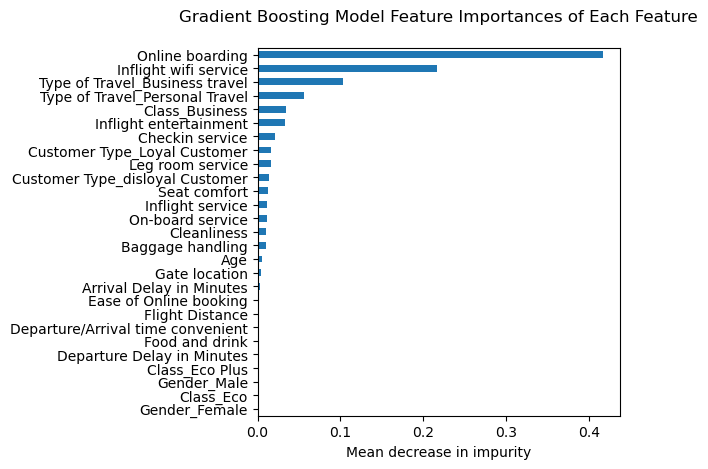

In [ ]:
### Showing the Feature Importance for Each Feature ###

# Build gradient boosted model with the best hyperparameters obtained from halving grid search cv
gbc_air_best_params = GradientBoostingClassifier(**gbc_halving_grid_search.best_params_, random_state=333).fit(X_train_air_scaled, y_train_air)

# Extract the importance scores of each features
air_importances = gbc_air_best_params.feature_importances_
sort_air_idx = np.argsort(air_importances) # sort by importances descendingly
air_importances = air_importances[sort_air_idx]

# Extract the name of each features
air_feature_names = gbc_air_best_params.feature_names_in_
air_feature_names = air_feature_names[sort_air_idx] # sort the feature names based on descending order of importance scores

# Combine both the importances score and feature names in a Pandas Series
gbc_air_importances = pd.Series(air_importances, index=air_feature_names)

fig, ax = plt.subplots()
gbc_air_importances.plot.barh(ax=ax)
ax.set_title("Gradient Boosting Model Feature Importances of Each Feature", y=1.05)
ax.set_xlabel("Mean decrease in impurity")
fig.tight_layout()

### f. Bagging Classifier

In [ ]:
### Model Building & Performance in Training Set ###

bc_estimator = LogisticRegression() # logistic regression will be used as the base estimator for bagging
bc_mod_air = BaggingClassifier(estimator=bc_estimator, random_state=123)

# Measure training model running time
start_time = time.time()
bc_mod_air.fit(X_train_air_scaled, y_train_air)
end_time = time.time()
train_time = end_time - start_time

# Measure prediction time
start_time = time.time()
y_train_bc_pred = bc_mod_air.predict(X_train_air_scaled)
end_time = time.time()
prediction_time = end_time - start_time

# Compute some evaluation scores
bc_mod_air_train_precision = precision_score(y_train_air, y_train_bc_pred)
bc_mod_air_train_f1 = f1_score(y_train_air, y_train_bc_pred)
bc_mod_air_train_auc = roc_auc_score(y_train_air, y_train_bc_pred)

print('Bagging classifier model training set performances: ')
print(f'Precision score: {bc_mod_air_train_precision}')
print(f'F1 score: {bc_mod_air_train_f1}')
print(f'AUC score: {bc_mod_air_train_auc}')

print(f'\nModel training time: {train_time:.3f} seconds')
print(f'Model prediction time: {prediction_time:.3f} seconds')

Bagging classifier model training set performances: 
Precision score: 0.8704575496857679
F1 score: 0.8528937262832602
AUC score: 0.8704289875648229

Model training time: 5.109 seconds
Model prediction time: 0.309 seconds


In [ ]:
### Validation Set Performance ###

bc_mod_air_val_precision = cross_val_score(bc_mod_air, X_train_air_scaled, y_train_air,
                                            scoring="precision", cv=5)
bc_mod_air_val_f1 = cross_val_score(bc_mod_air, X_train_air_scaled, y_train_air,
                                     scoring="f1", cv=5)
bc_mod_air_val_auc = cross_val_score(bc_mod_air, X_train_air_scaled, y_train_air,
                                      scoring="roc_auc", cv=5)

print('Gradient boosted model validation set performances: ')
print(f'Average precision score: {np.mean(bc_mod_air_val_precision)}')
print(f'Average F1 score: {np.mean(bc_mod_air_val_f1)}')
print(f'Average AUC score: {np.mean(bc_mod_air_val_auc)}')

Gradient boosted model validation set performances: 
Average precision score: 0.8701794977178358
Average F1 score: 0.8526684142117485
Average AUC score: 0.9266862007913034


From the 2 cells above, it can be seen that using logistic regression as the base estimator for bagging classifier yield similar result with only using single logistic regression model. Similar with single logistic regression performance, bagging classifier with logistic regression as the base estimator increase the AUC score around 5.5% from training to validation set.

In [ ]:
### Hyperparameters Tuning ###

warnings.filterwarnings('ignore')

bc_air_params = {
        'n_estimators': [10, 50, 100],
        'max_samples': [0.5, 0.7, 1.0],
        'max_features': [0.5, 0.7, 1.0],
        'estimator__penalty': ['l1', 'l2'],
        'estimator__C': [0.01, 0.1, 1.0, 10.0],
        'estimator__solver': ['liblinear', 'saga'],
        'estimator__max_iter': [50, 100, 200]
         }

# Halving grid search CV is used instead of grid search CV because it is faster in terms of computing time
bc_halving_grid_search = HalvingGridSearchCV(
    estimator=bc_mod_air,
    param_grid=bc_air_params,
    cv=5,
    scoring='precision',
    random_state=333
)

# Measure running time of the model
start_time = time.time()
bc_halving_grid_search.fit(X_train_air_scaled, y_train_air)
end_time = time.time()
running_time = end_time - start_time

# print halving grid search cv results
print("Gradient boosted halving grid search CV best parameters:", bc_halving_grid_search.best_params_)
print("Best mean score:", bc_halving_grid_search.best_score_)

# print running time result
print(f'\nModel running time: {running_time/60:.2f} minutes')

Gradient boosted halving grid search CV best parameters: {'estimator__C': 0.01, 'estimator__max_iter': 50, 'estimator__penalty': 'l2', 'estimator__solver': 'liblinear', 'max_features': 0.5, 'max_samples': 0.7, 'n_estimators': 50}
Best mean score: 0.8729347919865502

Model running time: 134.36 minutes


It can be seen from the above cell that the best hyperparameters of bagging classifier could only improve the precision score around 0.3%. This could indicate that both the bagging classifier model with default hyperparameters and best hyperparameters can be choosen because their performance, based on the precision score, do not differ significantly.

### g. Xtreme Gradient Boosting Classifier

In [ ]:
### Model Building & Performance in Training Set ###

xgb_mod_air = XGBClassifier(random_state=123)

# Measure training model running time
start_time = time.time()
xgb_mod_air.fit(X_train_air_scaled, y_train_air)
end_time = time.time()
train_time = end_time - start_time

# Measure prediction time
start_time = time.time()
y_train_xgb_pred = xgb_mod_air.predict(X_train_air_scaled)
end_time = time.time()
prediction_time = end_time - start_time

# Compute some evaluation scores
xgb_mod_air_train_precision = precision_score(y_train_air, y_train_xgb_pred)
xgb_mod_air_train_f1 = f1_score(y_train_air, y_train_xgb_pred)
xgb_mod_air_train_auc = roc_auc_score(y_train_air, y_train_xgb_pred)

print('Xtreme gradient boosting classifier model training set performances: ')
print(f'Precision score: {xgb_mod_air_train_precision}')
print(f'F1 score: {xgb_mod_air_train_f1}')
print(f'AUC score: {xgb_mod_air_train_auc}')

print(f'\nModel training time: {train_time:.3f} seconds')
print(f'Model prediction time: {prediction_time:.3f} seconds')

Xtreme gradient boosting classifier model training set performances: 
Precision score: 0.9838930774503084
F1 score: 0.9713873256115578
AUC score: 0.9735923282984729

Model training time: 2.459 seconds
Model prediction time: 0.425 seconds


In [ ]:
### Validation Set Performance ###

xgb_mod_air_val_precision = cross_val_score(xgb_mod_air, X_train_air_scaled, y_train_air,
                                            scoring="precision", cv=5)
xgb_mod_air_val_f1 = cross_val_score(xgb_mod_air, X_train_air_scaled, y_train_air,
                                     scoring="f1", cv=5)
xgb_mod_air_val_auc = cross_val_score(xgb_mod_air, X_train_air_scaled, y_train_air,
                                      scoring="roc_auc", cv=5)

print('Xtreme gradient boosting classifier model validation set performances: ')
print(f'Average precision score: {np.mean(xgb_mod_air_val_precision)}')
print(f'Average F1 score: {np.mean(xgb_mod_air_val_f1)}')
print(f'Average AUC score: {np.mean(xgb_mod_air_val_auc)}')

Xtreme gradient boosting classifier model validation set performances: 
Average precision score: 0.9700803885258888
Average F1 score: 0.9567039906873746
Average AUC score: 0.9949808468998549


It can be seen from the 2 cells above that the XGBoost model experienced decrease in precision score and F1 score around 1.4% and 1.5% consecutively. However, the AUC score experienced the opposite where it increase roughly 2.2%.

In [ ]:
### Hyperparameters Tuning ###

warnings.filterwarnings('ignore')

xgb_air_params = {
         'n_estimators': [50, 100, 200],
         'learning_rate': [0.01, 0.1, 0.3],
         'max_depth': [3, 5, 7],
         'subsample': [0.8, 1.0],
         'colsample_bytree': [0.8, 1.0]
         }

# Halving grid search CV is used instead of grid search CV because it is faster in terms of computing time
xgb_halving_grid_search = HalvingGridSearchCV(
     estimator=xgb_mod_air,
     param_grid=xgb_air_params,
     cv=5,
     scoring='precision',
     random_state=333
)

# Measure running time of the model
start_time = time.time()
xgb_halving_grid_search.fit(X_train_air_scaled, y_train_air)
end_time = time.time()
running_time = end_time - start_time

# print halving grid search cv results
print("Xtreme gradient boosting halving grid search CV best parameters:", xgb_halving_grid_search.best_params_)
print("Best mean score:", xgb_halving_grid_search.best_score_)

# print running time result
print(f'\nModel running time: {running_time/60:.2f} minutes')

Xtreme gradient boosting halving grid search CV best parameters: {'colsample_bytree': 0.8, 'learning_rate': 0.1, 'max_depth': 7, 'n_estimators': 200, 'subsample': 1.0}
Best mean score: 0.9736914465441566

Model running time: 6.22 minutes


From the cell above, it can be seen that the best hyperparameters for xtreme gradient boosting classsifier model are 80% fraction of features randomly sampled for each tree (colsample_bytree: 0.8), learning rate of 0.1, maximum depth of 7 for each tree, 200 trees to be built, and 100% fraction of training data randomly sampled for each tree (subsample: 0.1). It can also be seen that tuning the hyperparameters for XGBClassifier did not increase the precision score much.

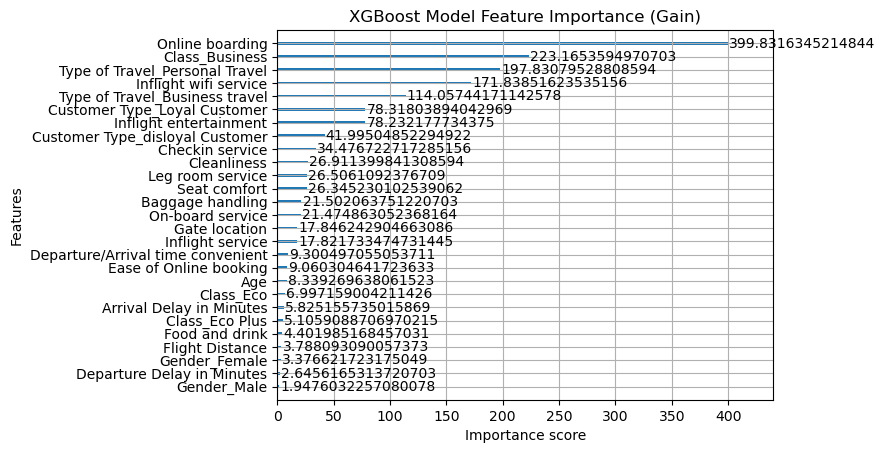

In [ ]:
### Plotting the Feature Importance ###

plot_importance(xgb_halving_grid_search.best_estimator_, importance_type='gain', title='XGBoost Model Feature Importance (Gain)')
plt.show()

From the plot above, the top 5 features that contributes the most to the airline customer's satisfaction are:
1. Online boarding
2. Business class
3. Personal type of travel
4. Inflight WIFI service
5. Business type of travel

It can be seen from the plot above that "Online boarding" is the feature that contributes the most to the airline customer's satisfaction. It significantly outweigh the second most important feature, which is dummy business for the class feature. This could indicate that seamless online boarding experience strongly influence whether a customer is satisfied or neutral or dissatisfied and the airline might want to prioritise this aspect more compared to the other aspects.

## Machine Learning Model (The Best Model) Evaluation on The Test Set

Based on the machine learning model building and hyperparameter fine tuning section above, it can be indicated and we can suggest that the best possible model for regular prediction is Xtreme Gradient Boosting Classifier. Below are several reasons why this model is presumably the best model for prediction purpose:
1. It has the best generalisation performance on the validation set compared to the other models with precision score around 0.97, F1-score around 0.96, and AUC score around 0.99. The precision score and F1-score experienced a small decrease from training set to validation set around 1.4% and 1.5% respectively.
2. It can still provide a quite fast computational time (roughly 2-3 seconds in training set and 7-8 minutes in hyperparameter tuning) with better overall evaluation metrics (precision, f1-score, and AUC) compared to the other models.
3. Based on the training and validation set, Xtreme Gradient Boosting Classifier did not experience a serious overfitting. Even though other models, like logistic regression and ANN, did not experience overfitting, both models have longer overall computational time and worse overall evaluation metric scores.

In [ ]:
### Classification Report on the Test Set ###

# Predict the test features using the best hyperparameter found by HalvingGridSearchCV method
xgb_y_pred = xgb_halving_grid_search.best_estimator_.predict(X_test_air_scaled)

# Create a variable that consist of the classification report that will generate the evaluation metrics
xgb_report = classification_report(y_test_air, xgb_y_pred)

print(xgb_report)

              precision    recall  f1-score   support

           0       0.96      0.98      0.97     14528
           1       0.97      0.94      0.96     11365

    accuracy                           0.96     25893
   macro avg       0.97      0.96      0.96     25893
weighted avg       0.96      0.96      0.96     25893



From the classification report above, it can be seen that Xtreme Gradient Boosting Classifier has outstanding evaluation metric scores in the test set. It has precision, recall, and f1-score above or equal to 0.94 for both the satisfied and neutral or dissatisfied classes of the target variable. These scores are significantly better than the reference code given (__roughly 20% better__ than the reference code). It also has better accuracy, macro average, and weighted average (__roughly 20% better__ than the reference code also).

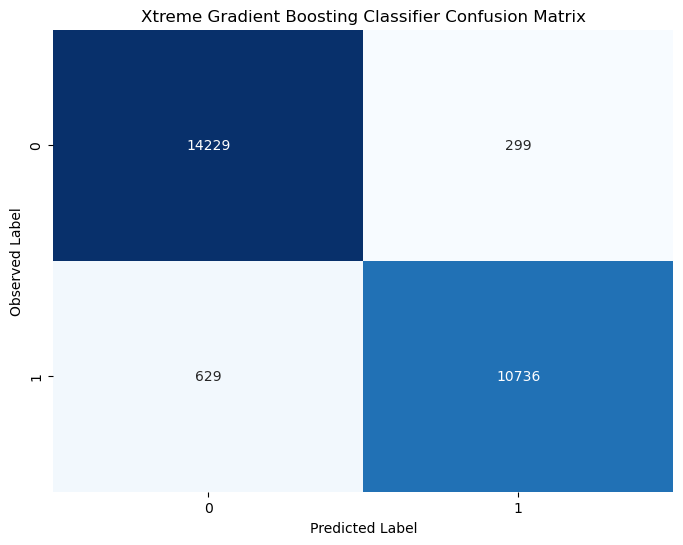

In [ ]:
### Visualise the Confusion Matrix ###

# Compute the confusion matrix
cm_xgb = confusion_matrix(y_test_air, xgb_y_pred)

# Create a heatmap for the confusion matrix
plt.figure(figsize=(8, 6))
sns.heatmap(cm_xgb, annot=True, fmt='d', cmap='Blues', cbar=False)
plt.title('Xtreme Gradient Boosting Classifier Confusion Matrix')
plt.xlabel('Predicted Label')
plt.ylabel('Observed Label')
plt.show()

From the confusion matrix above, it can be seen that Xtreme Gradient Boosting Classifier model can predict both classes exceptionally well. Out of 14,528 observations that are neutral or dissatisfied, it can predict around 98% of them correctly (neutral or dissatisfied class recall of around 0.98). Out of 11,365 observations that are satisfied, it can predict around 94.5% of them correctly (satisfied class recall of around 0.945).

__Summary__:

The model is performing strikingly well, with an __overall accuracy of 96%__. It can predicts both neutral or dissatisfied and satisfied customers well with precision scores of 0.96 and 0.97 correspondingly. On the other hand, it performs slightly better on neutral or dissatisfied customer (98% recall) compared to satisfied customer (94% recall).

## Business Insights

1. Using the output of logistic regression model, it can be indicated that every single feature in the data has statistically significant effect or impact to customers' satisfaction. To decide what feature needs to be prioritised first, the business team could utilise the feature importances plot of decision tree model and xtreme gradient boosting model. Both model suggest that the most important or contributing feature to customers' satisfaction is customers satisfaction level with the airline's online onboarding process. Hence, the business team could make this aspect as their top priority to improve first before eyeing on the other aspects or factors. For example, the business team could augment the online onboarding process of the airline by making the user interface friendlier and easier to use, reducing the number of technical issue that the customers might experience when interacting with the airline's online boarding platform, etc. Focussing on these solution could have the greatest impact on augmenting customer satisfaction.
2. Using the logistic regression coefficients, it can be seen that online boarding ($\beta=1.5368$), inflight wifi service ($\beta=0.7076$), and cleanliness ($\beta=0.6945$) are the strongest positive drivers of customer satisfaction. The business team could put greater emphasise on improving the online boarding processes, reliable inflight WIFI, and maintaining clean cabins to boost customer satisfaction.
3. Using the logistic regression coefficients, it can be seen that personal type of travel ($\beta=-2.4578$), disloyal customer type ($\beta=-1.4278$), economy class customer ($\beta=-1.621$), and economy plus class customer ($\beta=-1.456$) have the largest negative effects. These could indicate that those type of passengers are much less likely to be satisfied. The business team could improve the services to personal travelers by giving more entertainment, better pricing, etc. They could also offer incentives to disloyal customers (e.g., making the loyalty program rewards more appealing) to improve their experiences. Furthermore, they can improve the experience of Economy and Economy Plus passengers (e.g., making the seats more convenient, more amenities, etc.) to reduce the gap with Business Class passengers.
4. Using the logistic regression gender coefficient ($\beta_{male}=0.5172$), it can be seen that male passengers are more likely to be satisfied compared to the females. Since female passengers constitute more than 50% of the whole data (52,727 of them in the train set), the business team might want to investigate why females are less likely to be satisfied (e.g., develop and distribute survey specifically taylored for female passengers) and address those concerns.
5.  Using the logistic regression coefficient for flight distance ($\beta=0.3681$), it can indicate that longer distance flights are more likely to be associated with higher satisfaction. This could indicate that longer flights may offer better services (e.g., meals, entertainment, etc.).